In [ ]:
pip install -U transformers diffusers accelerate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 122.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 95.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 54.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 11.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 42.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 19.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 106.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvji

In [ ]:
pip install datasets Pillow tqdm opencv-python

In [ ]:
!pip install open_clip_torch ftfy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 27.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 4.0 MB/s eta 0:00:00


In [ ]:
import glob
import json
import os
import random
from PIL import Image
import tensorboard
import torch
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from tqdm import tqdm
from google.colab import drive
from diffusers import (
    AutoencoderKL,
    DDIMScheduler,
    DDPMScheduler,
    UNet2DConditionModel,
)
from diffusers import DPMSolverMultistepScheduler
from transformers import CLIPTextModel, CLIPTokenizer, get_cosine_schedule_with_warmup
import numpy as np
from PIL import ImageDraw
import matplotlib.pyplot as plt
from torch.optim import AdamW
from torch.nn.utils import clip_grad_norm_
from torch.optim.lr_scheduler import CosineAnnealingLR
import zipfile
from collections import defaultdict
from typing import List, Tuple
from torch import nn
from torchvision.models import inception_v3, Inception_V3_Weights
import open_clip
from scipy import linalg

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os
import shutil
import zipfile

# === 1. 來源檔案路徑（在雲端硬碟中） ===
drive_zip_path = "/content/drive/MyDrive/public_data/cropped.zip"
drive_json_path = "/content/drive/MyDrive/public_data/train_info.json"
drive_json_path_test = "/content/drive/MyDrive/public_data/test.json"
# === 2. 本機資料夾位置 ===
local_data_dir = "/content/crop"
os.makedirs(local_data_dir, exist_ok=True)

# === 3. 解壓 crop.zip 到本機資料夾 ===
with zipfile.ZipFile(drive_zip_path, 'r') as zip_ref:
    zip_ref.extractall(local_data_dir)
print("已解壓 crop.zip")

# === 4. 複製 JSON 標註檔到本機 ===
shutil.copy(drive_json_path, os.path.join("/content", "train_info.json"))
print("已複製 train_info.json")

drive_json_path_test = "/content/drive/MyDrive/public_data/test.json"
# === 4. 複製 JSON 標註檔到本機 ===
shutil.copy(drive_json_path_test, os.path.join("/content", "test.json"))
print("已複製 test.json")

已解壓 crop.zip
已複製 train_info.json
已複製 test.json


In [ ]:
def seed_everything(seed=2025):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)
    torch.backends.cudnn.deterministic = True

In [ ]:
# We provide a sample dataloader for this dataset, you can modify it as needed.
class TextImageDataset(Dataset):
    def __init__(self, data_root, caption_file, tokenizer, size=256):
        self.data_root = data_root
        self.tokenizer = tokenizer
        with open(caption_file, 'r') as f:
            self.captions = json.load(f)
        self.image_files = glob.glob(os.path.join(data_root, "*.png"))
        self.transform = transforms.Compose([
            transforms.Resize((size, size)),
            transforms.ToTensor(),
            transforms.Normalize([0.5], [0.5])
        ])

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_file = self.image_files[idx]

        ## Load image
        image = Image.open(img_file).convert("RGB")
        image = self.transform(image)

        ## Load text prompt
        # Image file name: "mosterID_ACTION_frameID.png"
        # key in "train_ingo.json": "mosterID_ACTION"
        key = img_file.split("/")[-1].split(".")[0]
        key = "_".join(key.split("_")[:-1])

        # Sample caption =  moster description + action description
        given_descriptions = self.captions[key]['given_description']
        given_description = random.choice(given_descriptions)
        caption = f"{given_description} {self.captions[key]['action_description']}"
        caption = "" if random.random() < 0.05 else caption
        inputs = self.tokenizer(caption, return_tensors="pt", padding="max_length", truncation=True, max_length=77).input_ids

        return {
            "pixel_values": image,
            "input_ids": inputs.squeeze(0),
        }

In [ ]:
@torch.no_grad()
def generate_and_save_images(unet, vae, text_encoder, tokenizer, epoch, device, save_folder, guidance_scale=2.0, enable_bar=False):
    unet.eval()
    noise_scheduler = DDPMScheduler()  # 預設值就是你訓練時的
    scheduler = DPMSolverMultistepScheduler.from_config(noise_scheduler.config)
    scheduler.set_timesteps(10)

    test_prompts = [
        "A red tree monster with a skull face and twisted branches.",
        "Blood-toothed monster with spiked fur, wielding an axe, and wearing armor. The monster is moving.",
        "Gray vulture monster with wings, sharp beak, and trident.",
        "Small, purple fish-like creature with large eye and pink fins. The monster is being hit.",
    ]
    images_list = []
    for i, prompt in enumerate(test_prompts):
        # Conditional and unconditional text embeddings
        cond_ids = tokenizer([prompt], return_tensors="pt", padding="max_length", truncation=True, max_length=77).input_ids.to(device)
        uncond_ids = tokenizer([""], return_tensors="pt", padding="max_length", truncation=True, max_length=77).input_ids.to(device)
        cond_emb = text_encoder(cond_ids)[0]
        uncond_emb = text_encoder(uncond_ids)[0]

        # Concatenate for classifier-free guidance
        encoder_input = torch.cat([uncond_emb, cond_emb], dim=0)

        latents = torch.randn((1, 4, 32, 32)).to(device)
        scheduler.set_timesteps(10)
        prog_bar = tqdm(scheduler.timesteps) if enable_bar else scheduler.timesteps

        for t in prog_bar:
            # Duplicate latents for both branches
            latent_input = latents.expand(2, -1, -1, -1)  # shape [2, 4, 32, 32]

            noise_pred = unet(latent_input, t.to(device), encoder_hidden_states=encoder_input).sample
            noise_pred_uncond, noise_pred_cond = noise_pred.chunk(2)

            # Classifier-free guidance
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_cond - noise_pred_uncond)

            latents = scheduler.step(noise_pred, t, latents).prev_sample

        # Decode
        latents = latents / 0.18215
        image = vae.decode(latents, return_dict=False)[0]
        image = (image.clamp(-1, 1) + 1) / 2
        image = transforms.ToPILImage()(image[0].cpu())
        images_list.append(image)

    # Display grid
    grid_img = Image.new('RGB', (2 * images_list[0].width, 2 * images_list[0].height))
    for idx, img in enumerate(images_list):
        row, col = divmod(idx, 2)
        grid_img.paste(img, (col * img.width, row * img.height))
    save_path = os.path.join(save_folder, f"epoch_{epoch:03d}.png")
    grid_img.save(save_path)

    plt.figure(figsize=(8, 8))
    plt.imshow(grid_img)
    plt.axis('off')
    plt.title(f"Generated Samples Epoch {epoch}")
    plt.show()
    unet.train()


In [ ]:
class EMA:
    def __init__(self, model, decay=0.9999):
        self.model = model
        self.decay = decay
        self.shadow = {}
        self.backup = {}

        # 初始化 shadow 權重
        for name, param in model.named_parameters():
            if param.requires_grad:
                self.shadow[name] = param.data.clone()

    def update(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                new_avg = (1.0 - self.decay) * param.data + self.decay * self.shadow[name]
                self.shadow[name] = new_avg.clone()

    def apply_shadow(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                self.backup[name] = param.data.clone()
                param.data = self.shadow[name]

    def restore(self):
        for name, param in self.model.named_parameters():
            if param.requires_grad:
                param.data = self.backup[name]
        self.backup = {}


In [ ]:
def train():
    seed_everything(2025)
    # ========= Hyperparameters ==========
    train_epochs = 60
    batch_size = 64
    gradient_accumulation_steps = 1
    # You can use gradients accumulation to simulate larger batch size if you have limited GPU memory.
    # Call optimizer.step() every `gradient_accumulation_steps` batches.
    lr = 2e-4

    device = "cuda" if torch.cuda.is_available() else "cpu"

    # ========== Saved folders ==========
    ckpt_folder = "/content/drive/MyDrive/DDIM11/ckpt"
    save_folder = "/content/drive/MyDrive/DDIM11/samples"
    os.makedirs(ckpt_folder, exist_ok=True)
    os.makedirs(save_folder, exist_ok=True)


    # ========== Load Pretrained Model ==========
    ## You cannot change this part
    pretrain_CLIP_path = "openai/clip-vit-base-patch32"
    pretrain_VAE_path = "CompVis/stable-diffusion-v1-4"

    # Load pre-trained CLIP tokenizer and text encoder
    tokenizer = CLIPTokenizer.from_pretrained(pretrain_CLIP_path)
    text_encoder = CLIPTextModel.from_pretrained(pretrain_CLIP_path).eval().to(device)
    text_encoder.requires_grad_(False)

    # Load pre-trained VAE
    vae = AutoencoderKL.from_pretrained(pretrain_VAE_path, subfolder="vae").to(device)
    vae.requires_grad_(False)

    # ========== Init ==========
    ## You should modify the model architecture by your self
    unet = UNet2DConditionModel(
    sample_size=32,
    in_channels=4,
    out_channels=4,
    layers_per_block=3,  # 每層更多 conv/block
    block_out_channels=(192, 384, 768),  # channel 加寬
    down_block_types=(
        "CrossAttnDownBlock2D",  # 支援 cross-attention
        "CrossAttnDownBlock2D",
        "CrossAttnDownBlock2D"
    ),
    up_block_types=(
        "CrossAttnUpBlock2D",
        "CrossAttnUpBlock2D",
        "CrossAttnUpBlock2D"
    ),
    cross_attention_dim=512,
    attention_head_dim=8  # 強化 attention 深度
    ).to(device)
    unet.train()
    ema = EMA(unet, 0.998)
    optimizer = AdamW(list(unet.parameters()), lr=lr, weight_decay=0.01)

    noise_scheduler = DDPMScheduler()
    noise_scheduler.set_timesteps(1000)

    # ========== Dataset ==========
    dataset = TextImageDataset(
    "/content/crop",
    "/content/train_info.json",
    tokenizer
    )

    print("✅ Dataset initialized")
    print("Dataset size:", len(dataset))

    if len(dataset) == 0:
        print("❌ Dataset is empty. Check your data paths or preprocessing logic.")
    else:
        sample = dataset[0]
        print("First sample keys:", sample.keys())
        print("Text tokens shape:", sample["input_ids"].shape)
        print("Pixel values shape:", sample["pixel_values"].shape)

    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    print(f"Dataset size: {len(dataset)}")
    print("Number of batches:", len(dataloader))
    # Test the generation pipeline
    num_training_steps = train_epochs * len(dataloader)
    warmup_steps = int(0.05 * num_training_steps)  # 前 5% warmup
    scheduler = get_cosine_schedule_with_warmup(
    optimizer,
    num_warmup_steps=warmup_steps,
    num_training_steps=num_training_steps
    )

    generate_and_save_images(unet, vae, text_encoder, tokenizer, 0, device, save_folder, guidance_scale=2.0, enable_bar=True)

    # ========== Training ==========
    loss_list = []
    lr_list = []
    loss_accumulated = 0.0
    step = 0
    for epoch in range(train_epochs):
        pbar = tqdm(dataloader)
        for batch in pbar:
            step += 1
            pixel_values = batch["pixel_values"].to(device)
            input_ids = batch["input_ids"].to(device)

            # Encode text and images
            with torch.no_grad():
                encoder_hidden_states = text_encoder(input_ids)[0]

                latents = vae.encode(pixel_values).latent_dist.sample()
                latents = latents * 0.18215  # Scaling

            # Sample noise and timestep
            noise = torch.randn_like(latents)
            timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (latents.shape[0],), device=device).long()
            noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

            # Predict noise
            noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states=encoder_hidden_states).sample

            loss = F.mse_loss(noise_pred.float(), noise.float(), reduction="mean")
            loss.backward()

            clip_grad_norm_(unet.parameters(), max_norm=1.0)
            optimizer.step()
            scheduler.step()
            ema.update()
            optimizer.zero_grad()
            loss_list.append(loss.item())
            pbar.set_description(f"Epoch {epoch+1} | Loss: {loss.item():.4f}")

        current_lr = scheduler.get_last_lr()[0]
        lr_list.append(current_lr)
        print(f"[Epoch {epoch+1}] Learning Rate: {current_lr:.8f}")

        if (10 <= epoch + 1 <= 35) or ((35 < epoch + 1 <= 44) and (epoch + 1) % 2 == 0) or ((44 < epoch + 1 ) and (epoch + 1) % 3 == 0) or (epoch + 1) == train_epochs:
            ema.apply_shadow()
            generate_and_save_images(unet, vae, text_encoder, tokenizer, epoch+1, device, save_folder, guidance_scale=2.0, enable_bar=True)
            torch.save({
            "step": step,
            "epoch": epoch,
            "unet": unet.state_dict(),
            "optimizer": optimizer.state_dict(),
            "scheduler": scheduler.state_dict() if scheduler else None,
            "ema": ema.shadow,
            "learning_rate": current_lr  # 額外記錄當下學習率
            }, os.path.join(ckpt_folder, f"checkpoint_epoch{epoch+1}.pt"))
            print(f"[Epoch {epoch+1}] Save Checkpoint")
            ema.restore()

    # ========== Plot Loss Curve After Training ==========
    plt.plot(loss_list)
    plt.xlabel("Iteration")
    plt.ylabel("Loss")
    plt.title("Training Loss Curve")
    plt.grid(True)
    plt.show()

    plt.figure()
    plt.plot(range(1, len(lr_list) + 1), lr_list)
    plt.xlabel("Step")

    plt.ylabel("Learning Rate")
    plt.title("Learning Rate Schedule")
    plt.grid(True)
    plt.show()


✅ Dataset initialized
Dataset size: 43294
First sample keys: dict_keys(['pixel_values', 'input_ids'])
Text tokens shape: torch.Size([77])
Pixel values shape: torch.Size([3, 256, 256])
Dataset size: 43294
Number of batches: 677


100%|██████████| 10/10 [00:00<00:00, 17.92it/s]


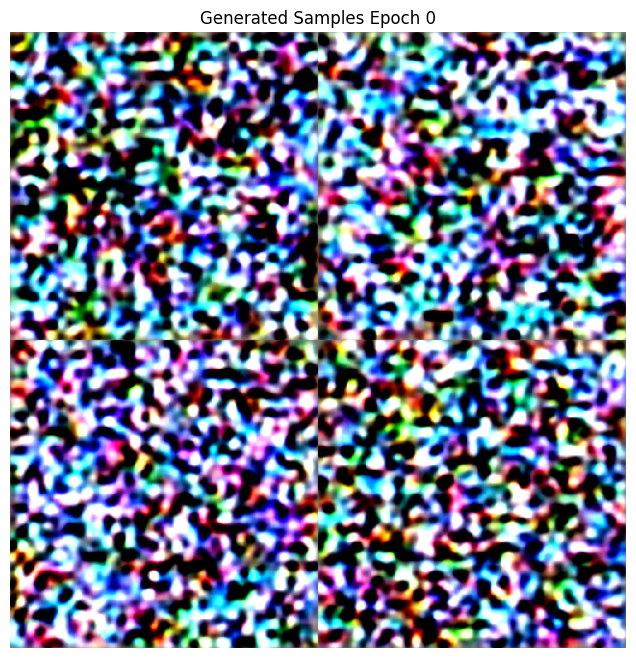

Epoch 1 | Loss: 0.1890: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 1] Learning Rate: 0.00006667


Epoch 2 | Loss: 0.1070: 100%|██████████| 677/677 [13:36<00:00,  1.21s/it]


[Epoch 2] Learning Rate: 0.00013333


Epoch 3 | Loss: 0.1612: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 3] Learning Rate: 0.00020000


Epoch 4 | Loss: 0.0731: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 4] Learning Rate: 0.00019985


Epoch 5 | Loss: 0.0919: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 5] Learning Rate: 0.00019939


Epoch 6 | Loss: 0.0406: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 6] Learning Rate: 0.00019864


Epoch 7 | Loss: 0.1360: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 7] Learning Rate: 0.00019758


Epoch 8 | Loss: 0.0609: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 8] Learning Rate: 0.00019623


Epoch 9 | Loss: 0.0845: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 9] Learning Rate: 0.00019458


Epoch 10 | Loss: 0.1368: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 10] Learning Rate: 0.00019265


100%|██████████| 10/10 [00:00<00:00, 17.78it/s]


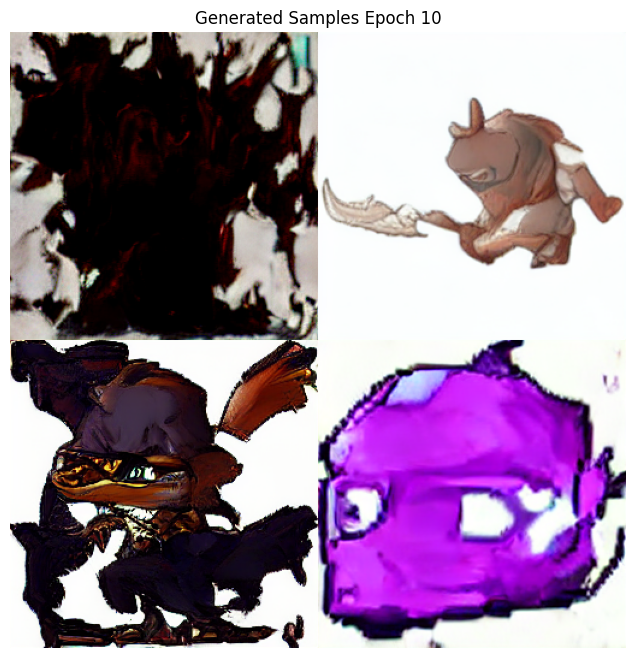

[Epoch 10] Save Checkpoint


Epoch 11 | Loss: 0.0762: 100%|██████████| 677/677 [13:36<00:00,  1.21s/it]


[Epoch 11] Learning Rate: 0.00019044


100%|██████████| 10/10 [00:00<00:00, 18.23it/s]


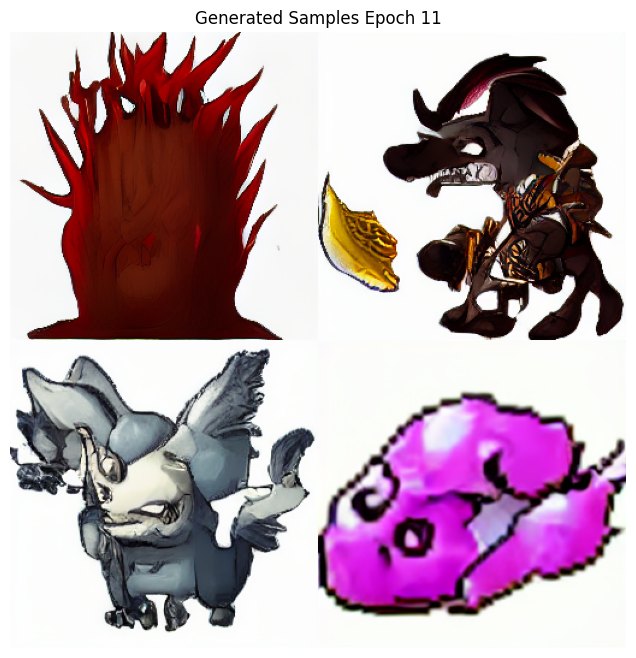

[Epoch 11] Save Checkpoint


Epoch 12 | Loss: 0.0957: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 12] Learning Rate: 0.00018795


100%|██████████| 10/10 [00:00<00:00, 17.87it/s]


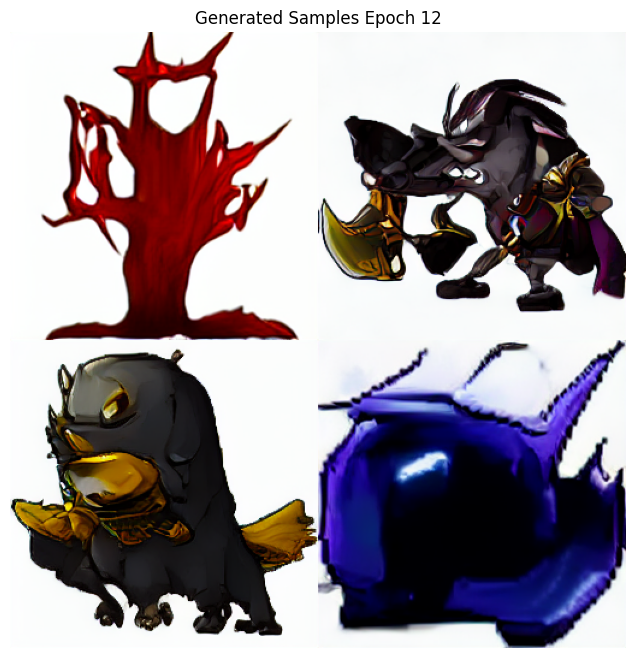

[Epoch 12] Save Checkpoint


Epoch 13 | Loss: 0.0314: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 13] Learning Rate: 0.00018519


100%|██████████| 10/10 [00:00<00:00, 17.79it/s]


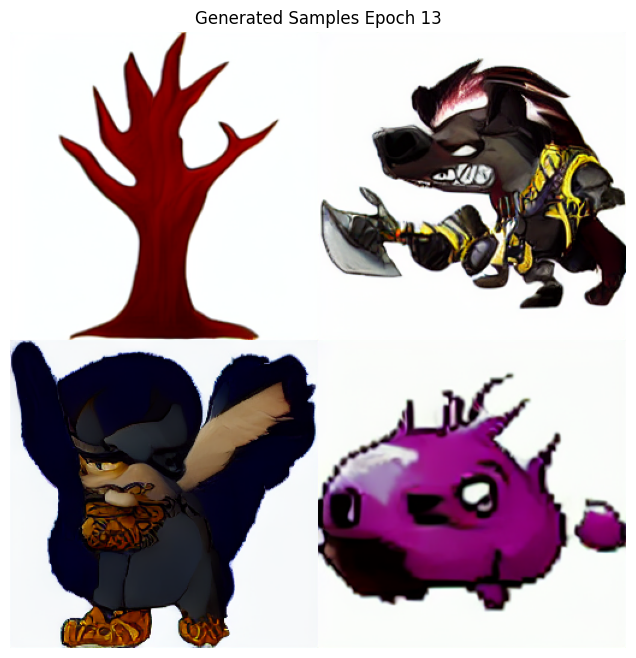

[Epoch 13] Save Checkpoint


Epoch 14 | Loss: 0.0662: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 14] Learning Rate: 0.00018218


100%|██████████| 10/10 [00:00<00:00, 17.50it/s]


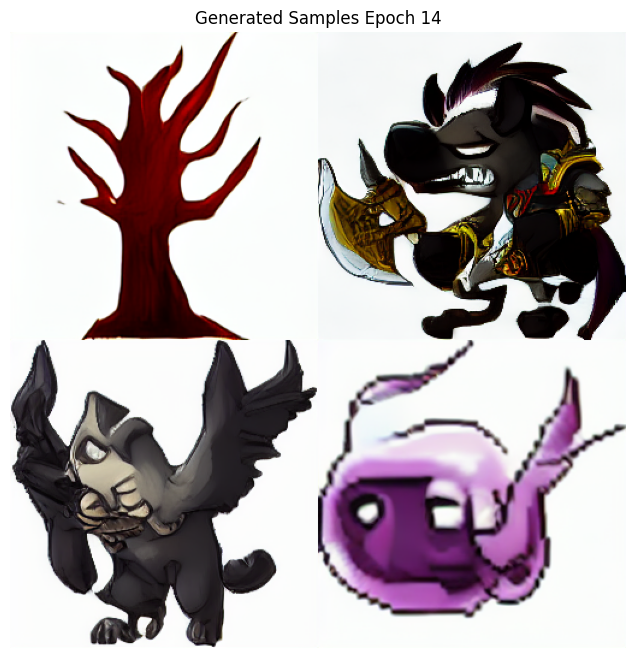

[Epoch 14] Save Checkpoint


Epoch 15 | Loss: 0.0724: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 15] Learning Rate: 0.00017891


100%|██████████| 10/10 [00:00<00:00, 17.46it/s]


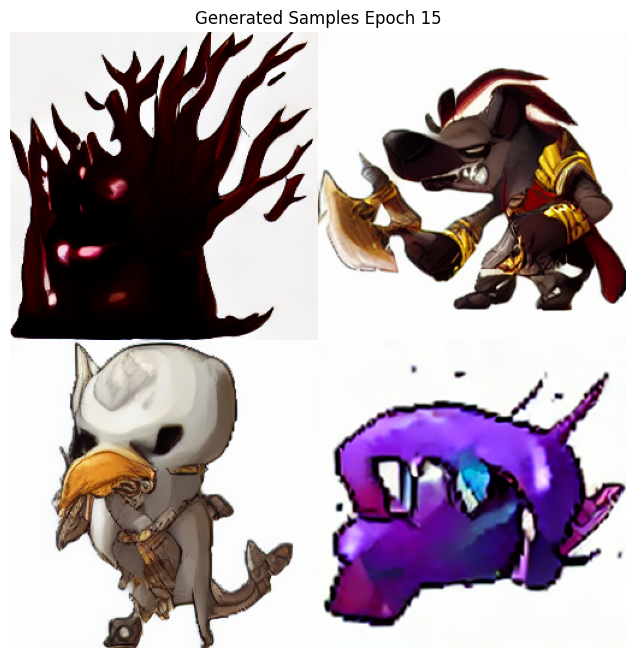

[Epoch 15] Save Checkpoint


Epoch 16 | Loss: 0.1630: 100%|██████████| 677/677 [13:36<00:00,  1.21s/it]


[Epoch 16] Learning Rate: 0.00017541


100%|██████████| 10/10 [00:00<00:00, 17.73it/s]


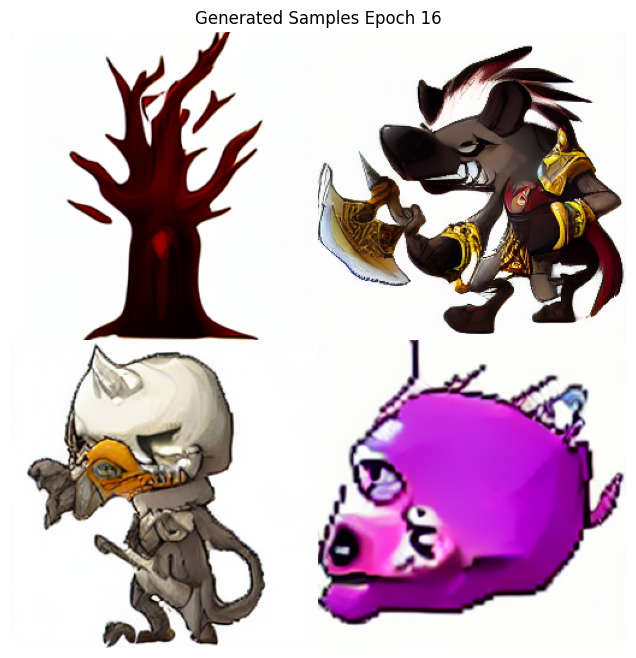

[Epoch 16] Save Checkpoint


Epoch 17 | Loss: 0.1288: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 17] Learning Rate: 0.00017168


100%|██████████| 10/10 [00:00<00:00, 17.54it/s]


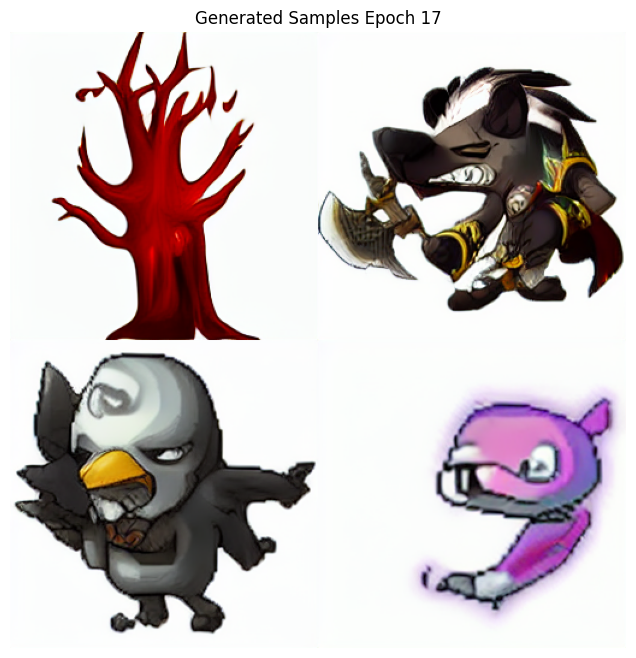

[Epoch 17] Save Checkpoint


Epoch 18 | Loss: 0.0751: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 18] Learning Rate: 0.00016773


100%|██████████| 10/10 [00:00<00:00, 17.30it/s]


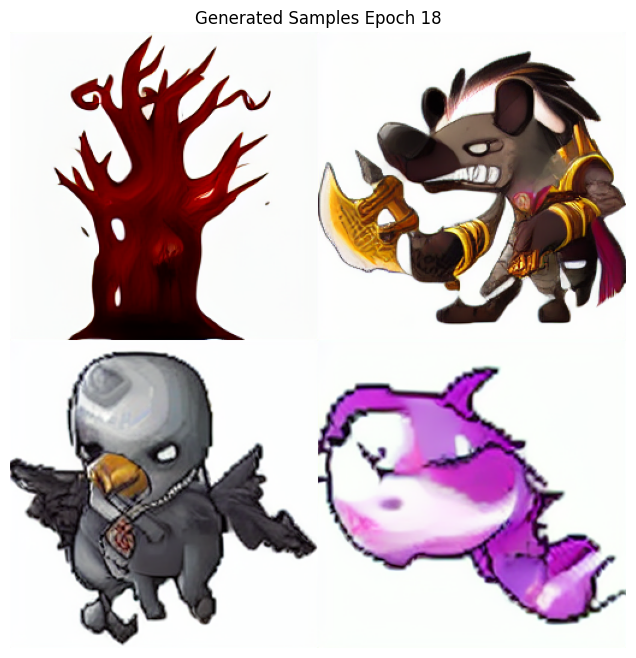

[Epoch 18] Save Checkpoint


Epoch 19 | Loss: 0.0789: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 19] Learning Rate: 0.00016357


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


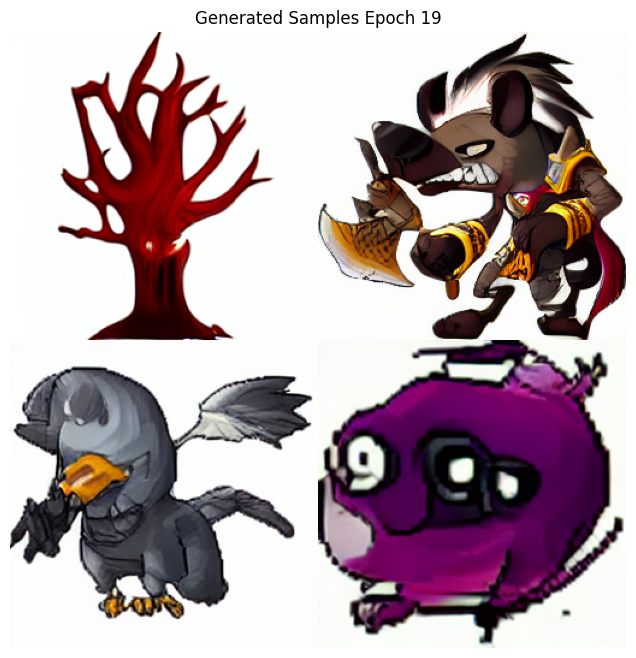

[Epoch 19] Save Checkpoint


Epoch 20 | Loss: 0.0622: 100%|██████████| 677/677 [13:36<00:00,  1.21s/it]


[Epoch 20] Learning Rate: 0.00015922


100%|██████████| 10/10 [00:00<00:00, 17.55it/s]


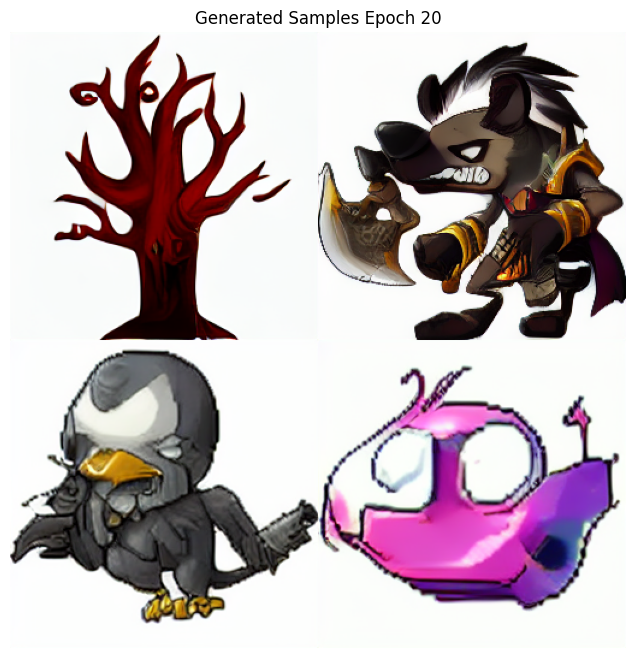

[Epoch 20] Save Checkpoint


Epoch 21 | Loss: 0.0771: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 21] Learning Rate: 0.00015469


100%|██████████| 10/10 [00:00<00:00, 17.91it/s]


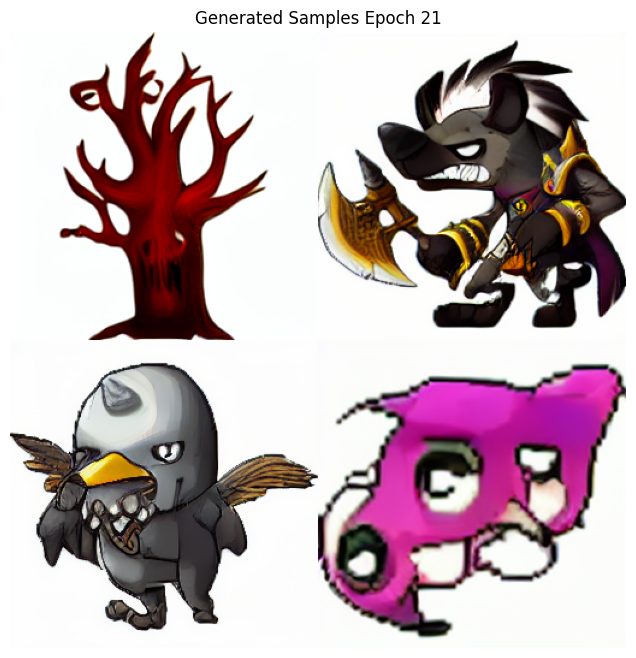

[Epoch 21] Save Checkpoint


Epoch 22 | Loss: 0.0776: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 22] Learning Rate: 0.00015000


100%|██████████| 10/10 [00:00<00:00, 18.38it/s]


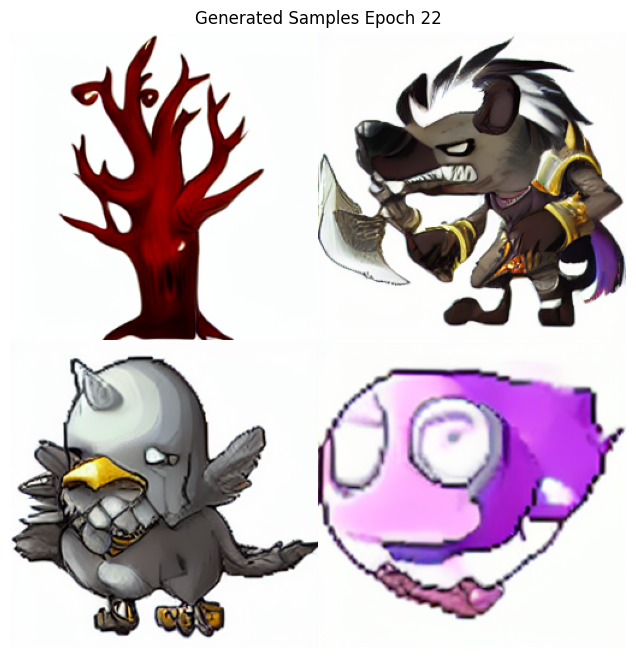

[Epoch 22] Save Checkpoint


Epoch 23 | Loss: 0.1010: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 23] Learning Rate: 0.00014515


100%|██████████| 10/10 [00:00<00:00, 17.57it/s]


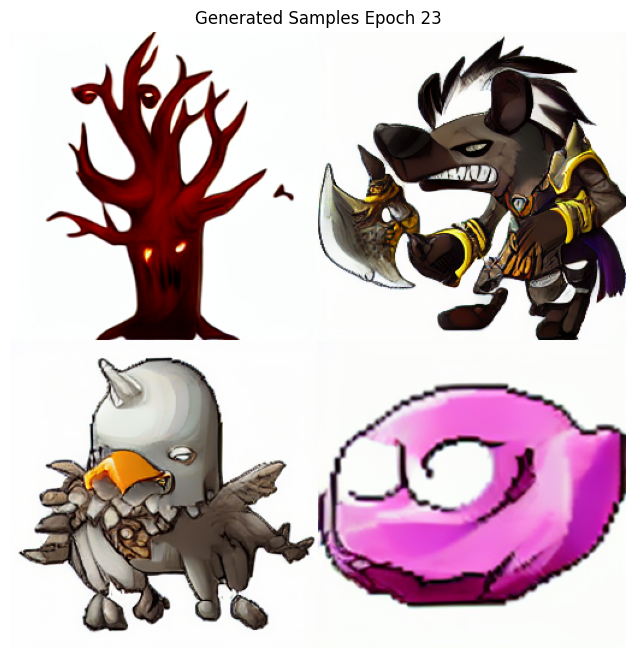

[Epoch 23] Save Checkpoint


Epoch 24 | Loss: 0.0541: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 24] Learning Rate: 0.00014017


100%|██████████| 10/10 [00:00<00:00, 18.11it/s]


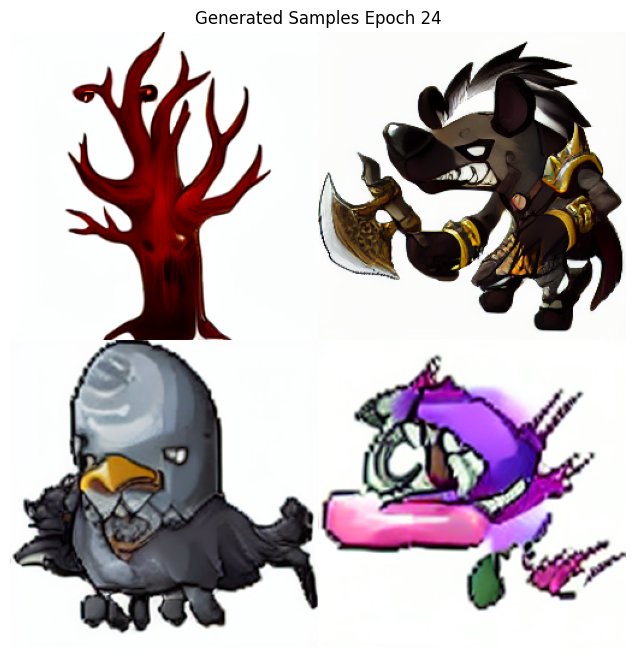

[Epoch 24] Save Checkpoint


Epoch 25 | Loss: 0.0697: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 25] Learning Rate: 0.00013506


100%|██████████| 10/10 [00:00<00:00, 16.79it/s]


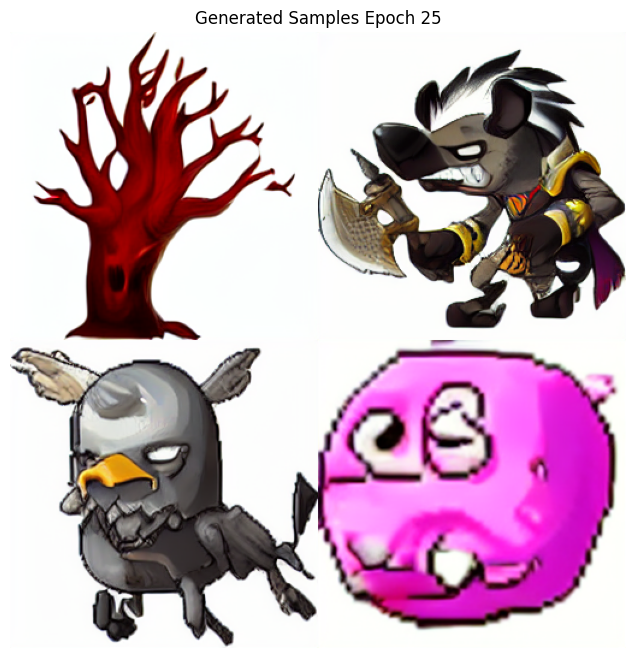

[Epoch 25] Save Checkpoint


Epoch 26 | Loss: 0.0798: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 26] Learning Rate: 0.00012985


100%|██████████| 10/10 [00:00<00:00, 17.68it/s]


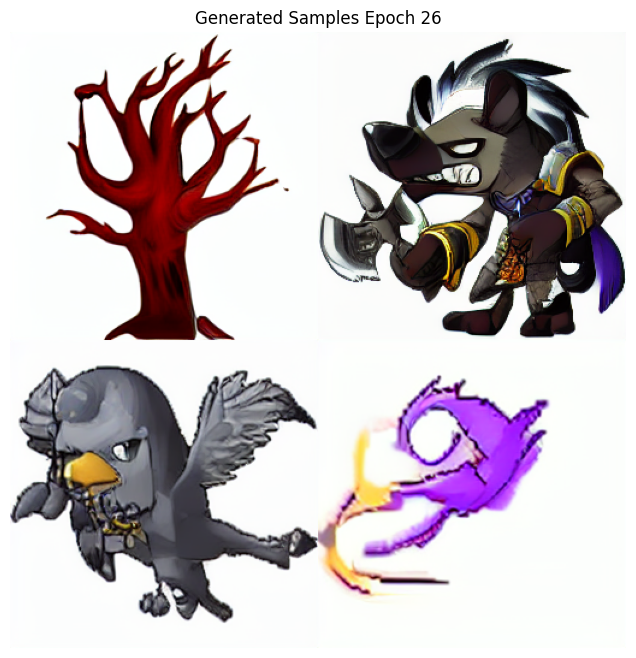

[Epoch 26] Save Checkpoint


Epoch 27 | Loss: 0.0893: 100%|██████████| 677/677 [13:39<00:00,  1.21s/it]


[Epoch 27] Learning Rate: 0.00012455


100%|██████████| 10/10 [00:00<00:00, 17.51it/s]


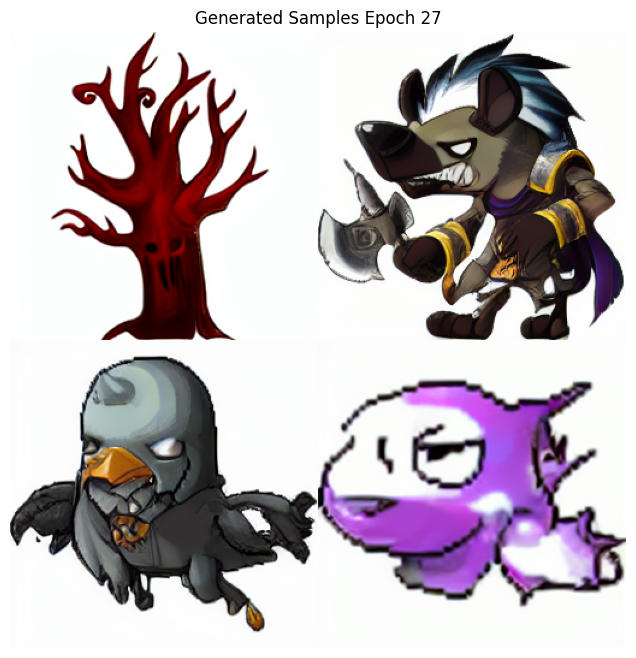

[Epoch 27] Save Checkpoint


Epoch 28 | Loss: 0.0551: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 28] Learning Rate: 0.00011917


100%|██████████| 10/10 [00:00<00:00, 15.93it/s]


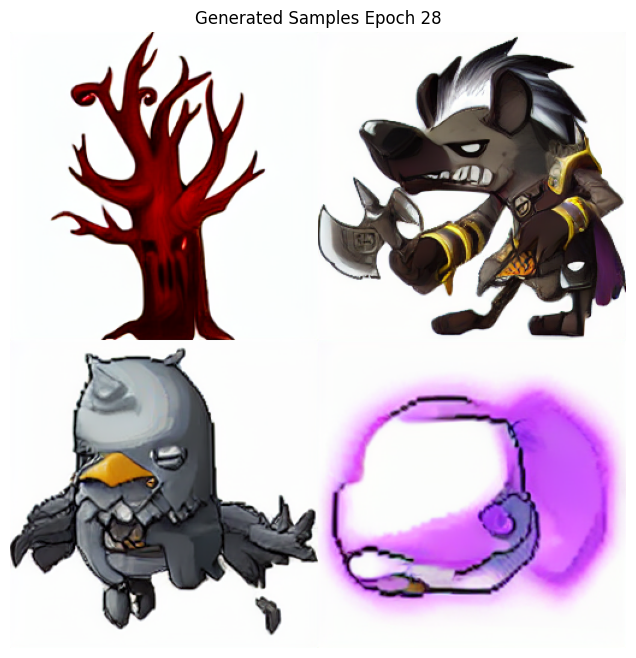

[Epoch 28] Save Checkpoint


Epoch 29 | Loss: 0.1463: 100%|██████████| 677/677 [13:37<00:00,  1.21s/it]


[Epoch 29] Learning Rate: 0.00011374


100%|██████████| 10/10 [00:00<00:00, 17.21it/s]


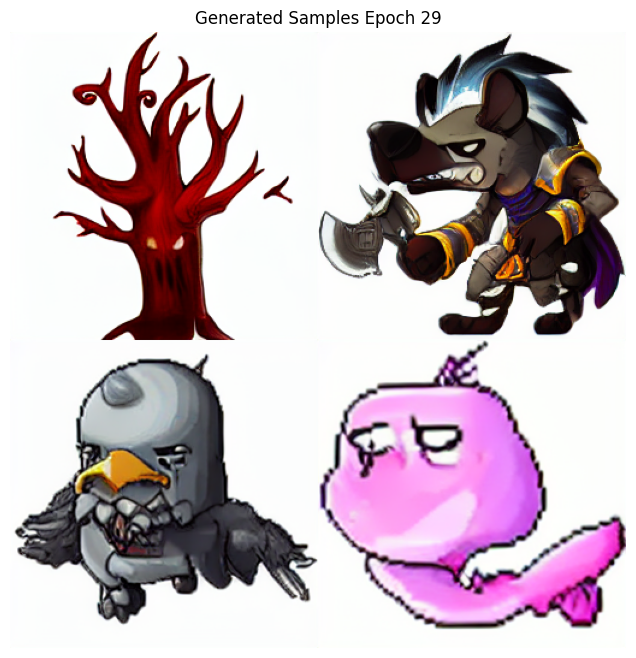

[Epoch 29] Save Checkpoint


Epoch 30 | Loss: 0.1007:  15%|█▌        | 103/677 [02:05<11:37,  1.22s/it]


OutOfMemoryError: CUDA out of memory. Tried to allocate 2.00 GiB. GPU 0 has a total capacity of 39.56 GiB of which 1.53 GiB is free. Process 3766 has 38.02 GiB memory in use. Of the allocated memory 14.80 GiB is allocated by PyTorch, and 22.72 GiB is reserved by PyTorch but unallocated. If reserved but unallocated memory is large try setting PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True to avoid fragmentation.  See documentation for Memory Management  (https://pytorch.org/docs/stable/notes/cuda.html#environment-variables)

In [ ]:
if __name__ == "__main__":
    train()

In [ ]:
def resume_train_from_checkpoint(resume_path, train_epochs=60):
    # ========= Basic Setup =========
    seed_everything(2025)
    batch_size = 64
    lr = 2e-4
    device = "cuda" if torch.cuda.is_available() else "cpu"
    ckpt_folder = os.path.dirname(resume_path)
    save_folder = "/content/drive/MyDrive/DDIM11/samples"

    tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-base-patch32")
    text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-base-patch32").eval().to(device)
    text_encoder.requires_grad_(False)
    vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae").to(device)
    vae.requires_grad_(False)

    unet = UNet2DConditionModel(
        sample_size=32,
        in_channels=4,
        out_channels=4,
        layers_per_block=3,
        block_out_channels=(192, 384, 768),
        down_block_types=(
            "CrossAttnDownBlock2D",
            "CrossAttnDownBlock2D",
            "CrossAttnDownBlock2D"
        ),
        up_block_types=(
            "CrossAttnUpBlock2D",
            "CrossAttnUpBlock2D",
            "CrossAttnUpBlock2D"
        ),
        cross_attention_dim=512,
        attention_head_dim=8
    ).to(device)
    unet.train()
    ema = EMA(unet, 0.998)
    optimizer = AdamW(list(unet.parameters()), lr=lr, weight_decay=0.01)

    noise_scheduler = DDPMScheduler()
    noise_scheduler.set_timesteps(1000)

    dataset = TextImageDataset("/content/crop", "/content/train_info.json", tokenizer)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)
    num_training_steps = train_epochs * len(dataloader)
    scheduler = CosineAnnealingLR(optimizer, T_max=num_training_steps, eta_min=1e-6)

    # ========= Resume =========
    checkpoint = torch.load(resume_path, map_location=device)
    unet.load_state_dict(checkpoint["unet"])
    optimizer.load_state_dict(checkpoint["optimizer"])
    if "scheduler" in checkpoint and checkpoint["scheduler"] is not None:
        scheduler.load_state_dict(checkpoint["scheduler"])
        print("✅ Resumed LR:", scheduler.get_last_lr()[0])
    ema.shadow = checkpoint["ema"]
    step = checkpoint.get("step", 0)
    start_epoch = checkpoint.get("epoch", 0) + 1
    print(f"✅ Resuming from epoch {start_epoch}, step {step}")

    # ========= Training Loop =========
    loss_list = []
    lr_list = []
    for epoch in range(start_epoch, train_epochs):
        pbar = tqdm(dataloader)
        for batch in pbar:
            step += 1
            pixel_values = batch["pixel_values"].to(device)
            input_ids = batch["input_ids"].to(device)

            with torch.no_grad():
                encoder_hidden_states = text_encoder(input_ids)[0]
                latents = vae.encode(pixel_values).latent_dist.sample() * 0.18215

            noise = torch.randn_like(latents)
            timesteps = torch.randint(0, noise_scheduler.config.num_train_timesteps, (latents.shape[0],), device=device).long()
            noisy_latents = noise_scheduler.add_noise(latents, noise, timesteps)

            noise_pred = unet(noisy_latents, timesteps, encoder_hidden_states=encoder_hidden_states).sample
            loss = F.mse_loss(noise_pred.float(), noise.float(), reduction="mean")
            loss.backward()

            clip_grad_norm_(unet.parameters(), max_norm=1.0)
            optimizer.step()
            scheduler.step()
            ema.update()
            optimizer.zero_grad()
            loss_list.append(loss.item())
            pbar.set_description(f"Epoch {epoch+1} | Loss: {loss.item():.4f}")

        current_lr = scheduler.get_last_lr()[0]
        lr_list.append(current_lr)
        print(f"[Epoch {epoch+1}] Learning Rate: {current_lr:.8f}")

        if (10 <= epoch + 1 <= 35) or ((35 < epoch + 1 <= 44) and (epoch + 1) % 2 == 0) or ((44 < epoch + 1 ) and (epoch + 1) % 3 == 0) or (epoch + 1) == train_epochs:
            ema.apply_shadow()
            generate_and_save_images(unet, vae, text_encoder, tokenizer, epoch+1, device, save_folder, guidance_scale=2.0, enable_bar=True)
            torch.save({
                "step": step,
                "epoch": epoch,
                "unet": unet.state_dict(),
                "optimizer": optimizer.state_dict(),
                "scheduler": scheduler.state_dict(),
                "ema": ema.shadow,
                "learning_rate": current_lr
            }, os.path.join(ckpt_folder, f"checkpoint_epoch{epoch+1}.pt"))
            print(f"[Epoch {epoch+1}] Save Checkpoint")
            ema.restore()

    # ========= Plotting =========
    plt.plot(loss_list)
    plt.xlabel("Iteration")
    plt.ylabel("Loss")
    plt.title("Training Loss Curve")
    plt.grid(True)
    plt.show()

    plt.figure()
    plt.plot(range(start_epoch + 1, start_epoch + 1 + len(lr_list)), lr_list)
    plt.xlabel("Epoch")
    plt.ylabel("Learning Rate")
    plt.title("Learning Rate Schedule")
    plt.grid(True)
    plt.show()


/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

✅ Resumed LR: 0.00011373535578184082
✅ Resuming from epoch 29, step 19633


Epoch 30 | Loss: 0.1094: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 30] Learning Rate: 0.00010813


100%|██████████| 10/10 [00:00<00:00, 17.80it/s]


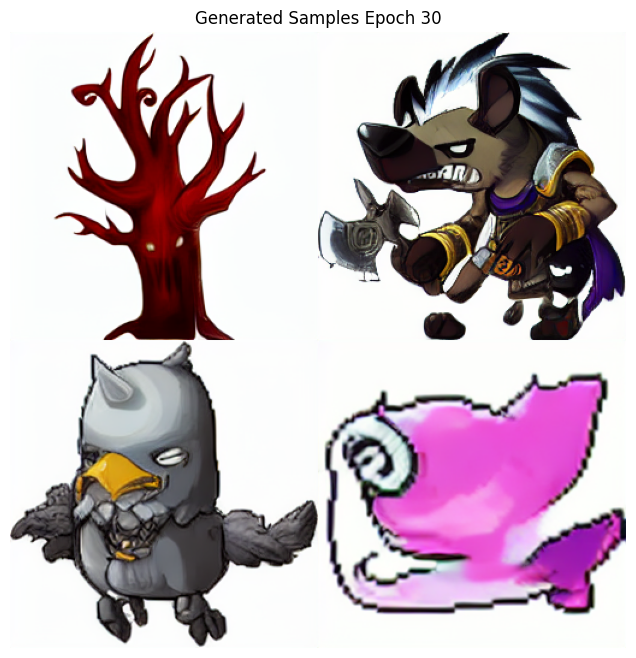

[Epoch 30] Save Checkpoint


Epoch 31 | Loss: 0.0702: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 31] Learning Rate: 0.00010252


100%|██████████| 10/10 [00:00<00:00, 18.93it/s]


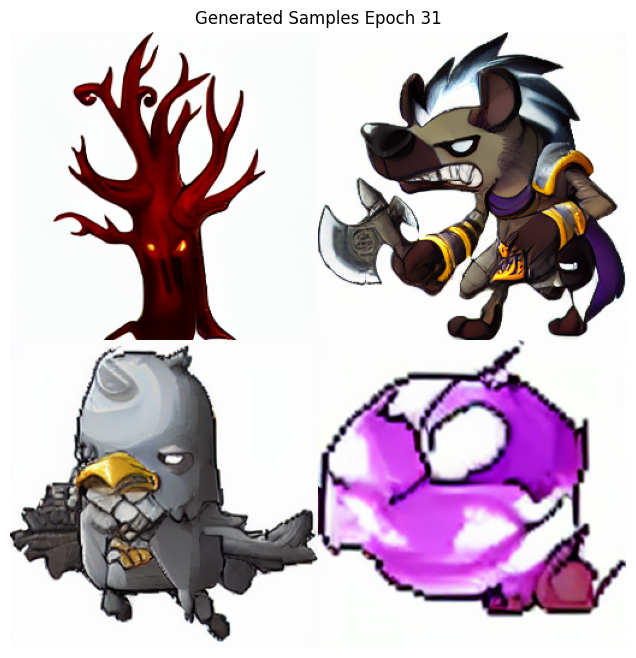

[Epoch 31] Save Checkpoint


Epoch 32 | Loss: 0.1112: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 32] Learning Rate: 0.00009693


100%|██████████| 10/10 [00:00<00:00, 18.79it/s]


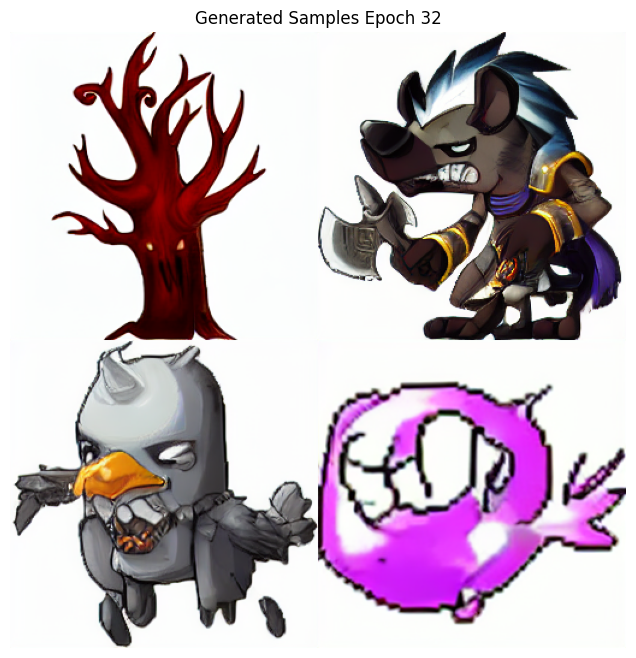

[Epoch 32] Save Checkpoint


Epoch 33 | Loss: 0.0441: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 33] Learning Rate: 0.00009137


100%|██████████| 10/10 [00:00<00:00, 18.59it/s]


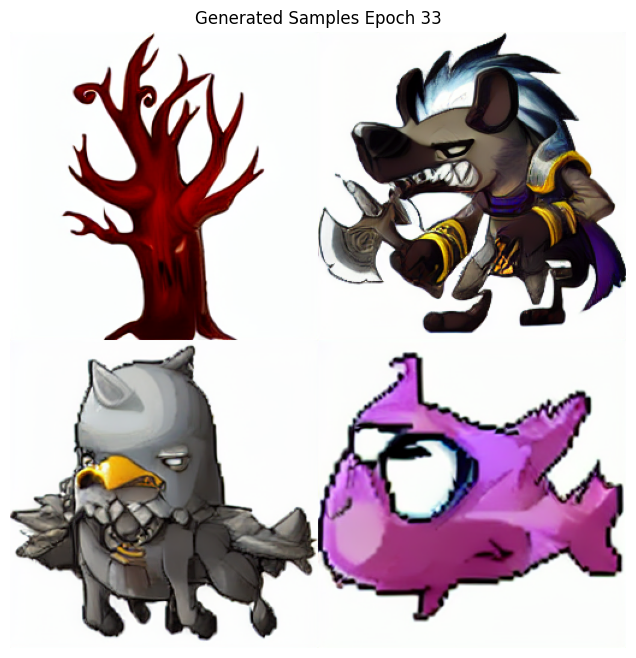

[Epoch 33] Save Checkpoint


Epoch 34 | Loss: 0.0612: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 34] Learning Rate: 0.00008586


100%|██████████| 10/10 [00:00<00:00, 17.48it/s]


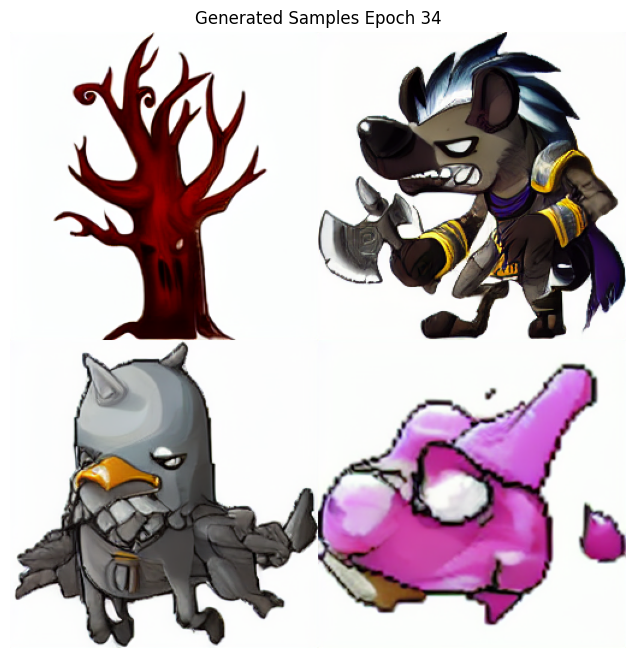

[Epoch 34] Save Checkpoint


Epoch 35 | Loss: 0.0313: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 35] Learning Rate: 0.00008040


100%|██████████| 10/10 [00:00<00:00, 18.33it/s]


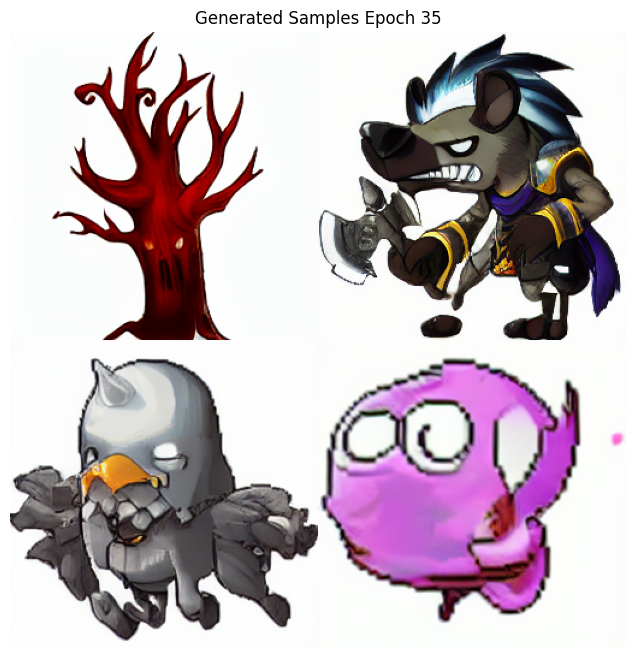

[Epoch 35] Save Checkpoint


Epoch 36 | Loss: 0.1011: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 36] Learning Rate: 0.00007502


100%|██████████| 10/10 [00:00<00:00, 18.04it/s]


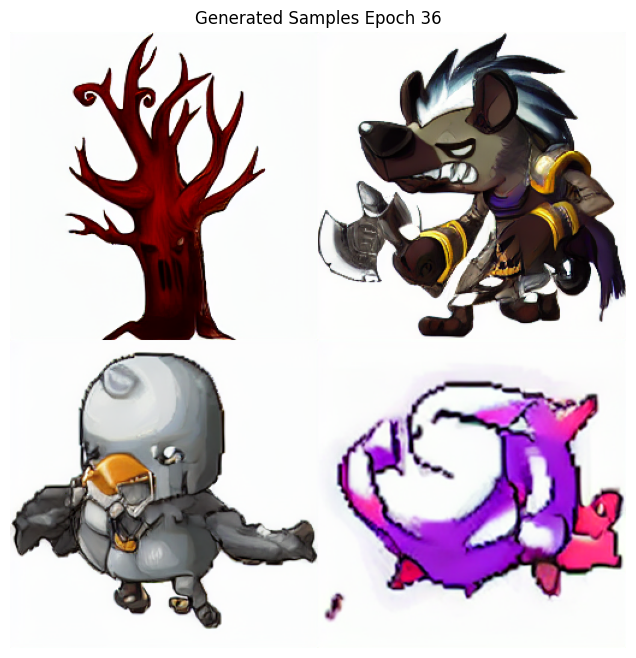

[Epoch 36] Save Checkpoint


Epoch 37 | Loss: 0.0543: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 37] Learning Rate: 0.00006974


Epoch 38 | Loss: 0.0522: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 38] Learning Rate: 0.00006456


100%|██████████| 10/10 [00:00<00:00, 17.32it/s]


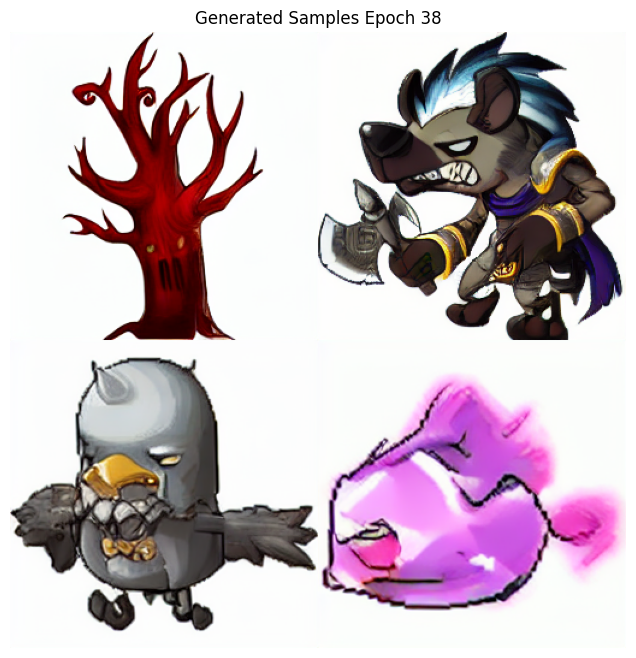

[Epoch 38] Save Checkpoint


Epoch 39 | Loss: 0.1095: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 39] Learning Rate: 0.00005949


Epoch 40 | Loss: 0.0498: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 40] Learning Rate: 0.00005456


100%|██████████| 10/10 [00:00<00:00, 16.18it/s]


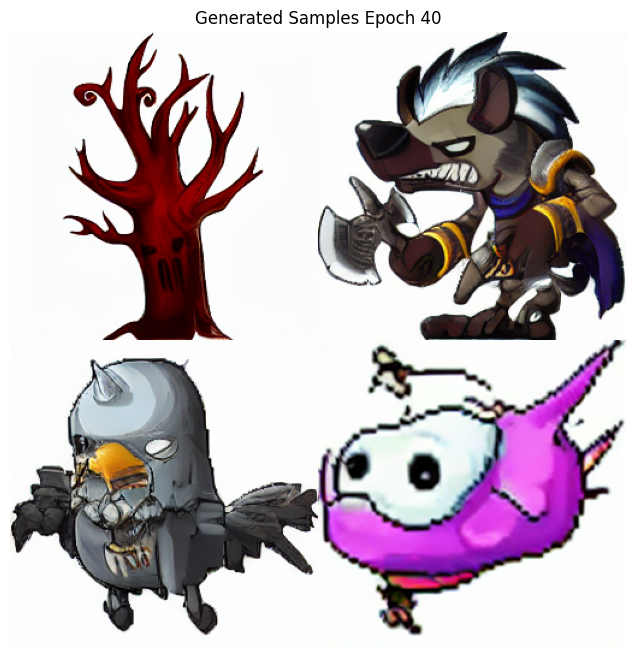

[Epoch 40] Save Checkpoint


Epoch 41 | Loss: 0.0721: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 41] Learning Rate: 0.00004978


Epoch 42 | Loss: 0.0303: 100%|██████████| 677/677 [14:00<00:00,  1.24s/it]


[Epoch 42] Learning Rate: 0.00004516


100%|██████████| 10/10 [00:00<00:00, 18.35it/s]


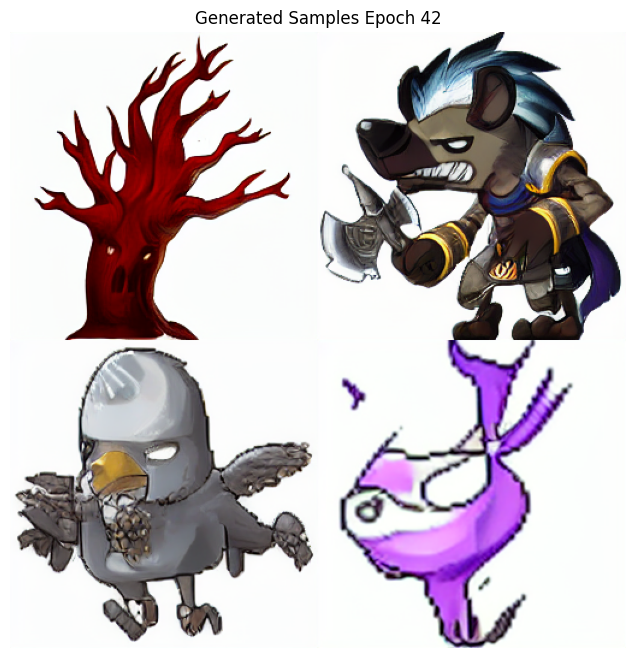

[Epoch 42] Save Checkpoint


Epoch 43 | Loss: 0.0464: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 43] Learning Rate: 0.00004071


Epoch 44 | Loss: 0.0534: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 44] Learning Rate: 0.00003645


100%|██████████| 10/10 [00:00<00:00, 18.01it/s]


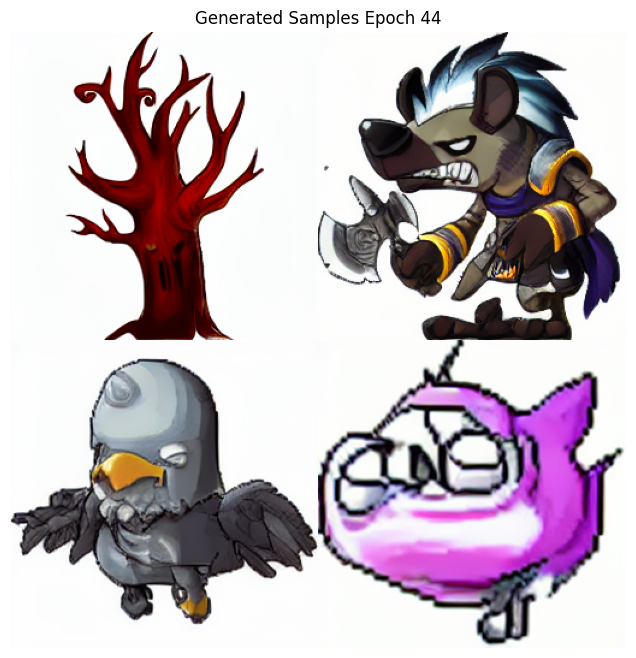

[Epoch 44] Save Checkpoint


Epoch 45 | Loss: 0.1297: 100%|██████████| 677/677 [14:00<00:00,  1.24s/it]


[Epoch 45] Learning Rate: 0.00003238


100%|██████████| 10/10 [00:00<00:00, 17.86it/s]


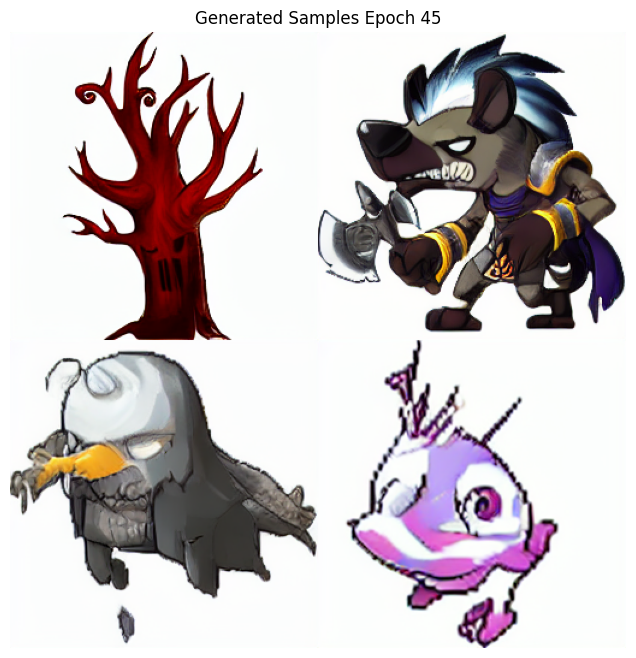

[Epoch 45] Save Checkpoint


Epoch 46 | Loss: 0.0819: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 46] Learning Rate: 0.00002852


Epoch 47 | Loss: 0.0555: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 47] Learning Rate: 0.00002487


Epoch 48 | Loss: 0.0621: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 48] Learning Rate: 0.00002146


100%|██████████| 10/10 [00:00<00:00, 17.75it/s]


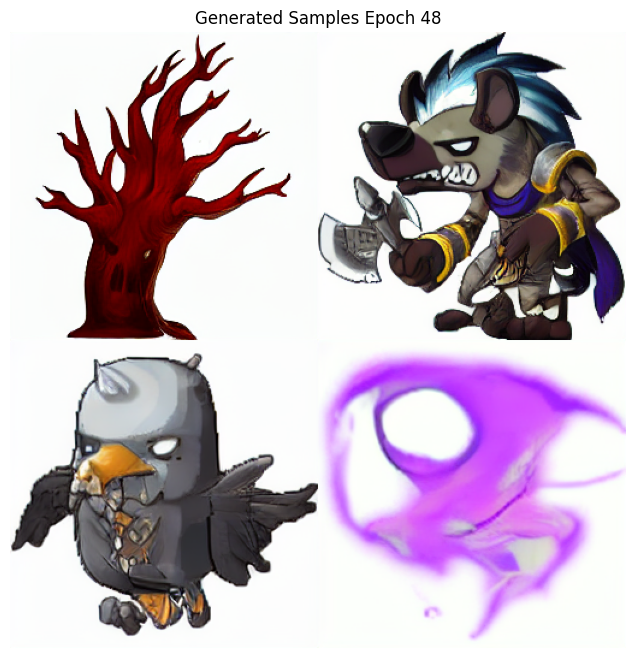

[Epoch 48] Save Checkpoint


Epoch 49 | Loss: 0.0514: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 49] Learning Rate: 0.00001828


Epoch 50 | Loss: 0.0637: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 50] Learning Rate: 0.00001535


Epoch 51 | Loss: 0.0622: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 51] Learning Rate: 0.00001268


100%|██████████| 10/10 [00:00<00:00, 17.73it/s]


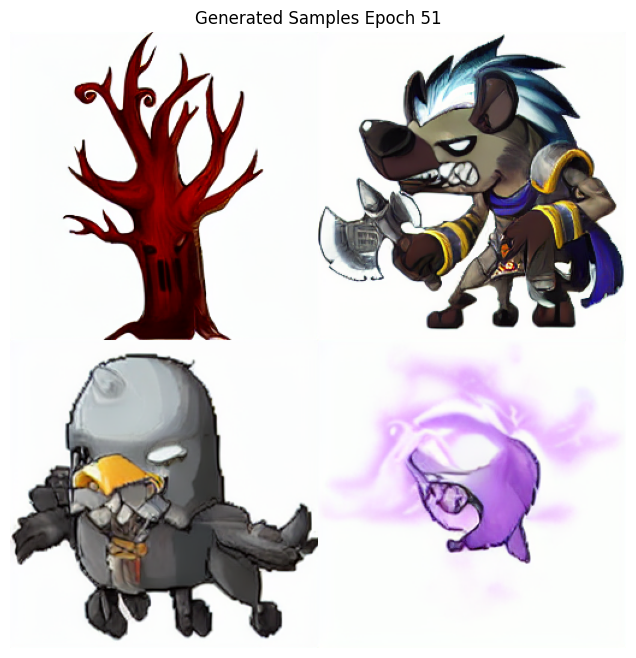

[Epoch 51] Save Checkpoint


Epoch 52 | Loss: 0.0760: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 52] Learning Rate: 0.00001026


Epoch 53 | Loss: 0.0320: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 53] Learning Rate: 0.00000812


Epoch 54 | Loss: 0.0417: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 54] Learning Rate: 0.00000624


100%|██████████| 10/10 [00:00<00:00, 17.95it/s]


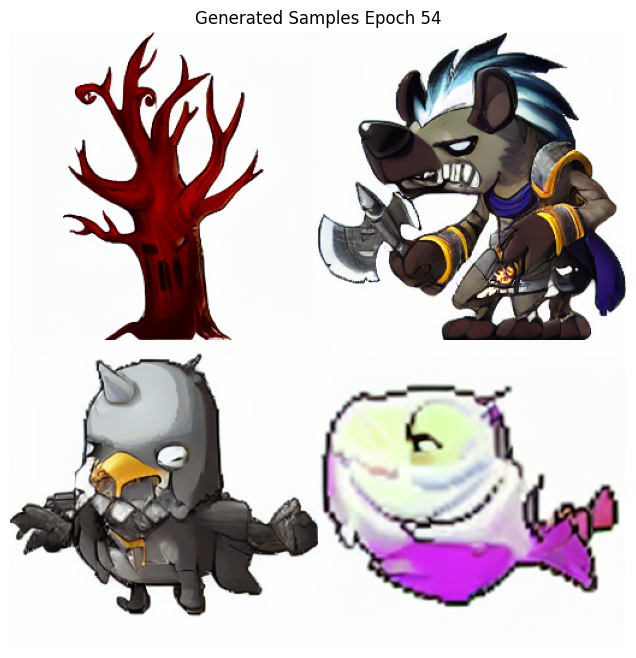

[Epoch 54] Save Checkpoint


Epoch 55 | Loss: 0.0748: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 55] Learning Rate: 0.00000465


Epoch 56 | Loss: 0.0694: 100%|██████████| 677/677 [14:00<00:00,  1.24s/it]


[Epoch 56] Learning Rate: 0.00000334


Epoch 57 | Loss: 0.0343: 100%|██████████| 677/677 [14:00<00:00,  1.24s/it]


[Epoch 57] Learning Rate: 0.00000232


100%|██████████| 10/10 [00:00<00:00, 17.99it/s]


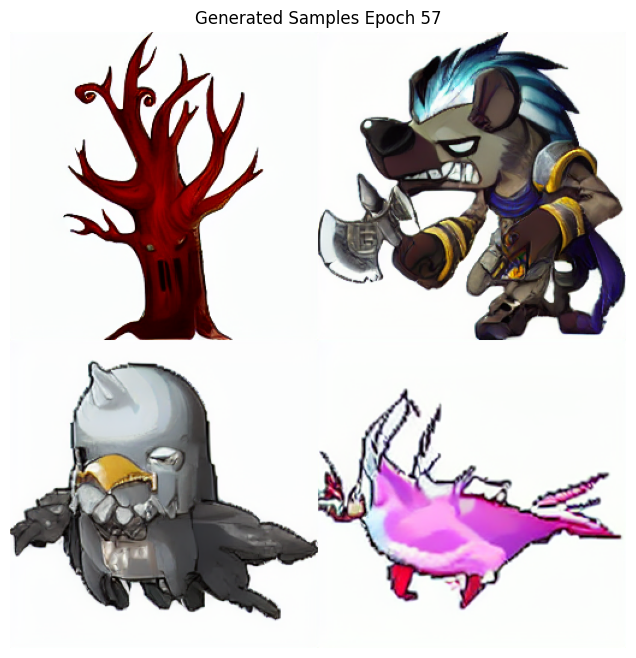

[Epoch 57] Save Checkpoint


Epoch 58 | Loss: 0.1105: 100%|██████████| 677/677 [13:58<00:00,  1.24s/it]


[Epoch 58] Learning Rate: 0.00000159


Epoch 59 | Loss: 0.1016: 100%|██████████| 677/677 [14:00<00:00,  1.24s/it]


[Epoch 59] Learning Rate: 0.00000115


Epoch 60 | Loss: 0.0416: 100%|██████████| 677/677 [13:59<00:00,  1.24s/it]


[Epoch 60] Learning Rate: 0.00000100


100%|██████████| 10/10 [00:00<00:00, 17.90it/s]


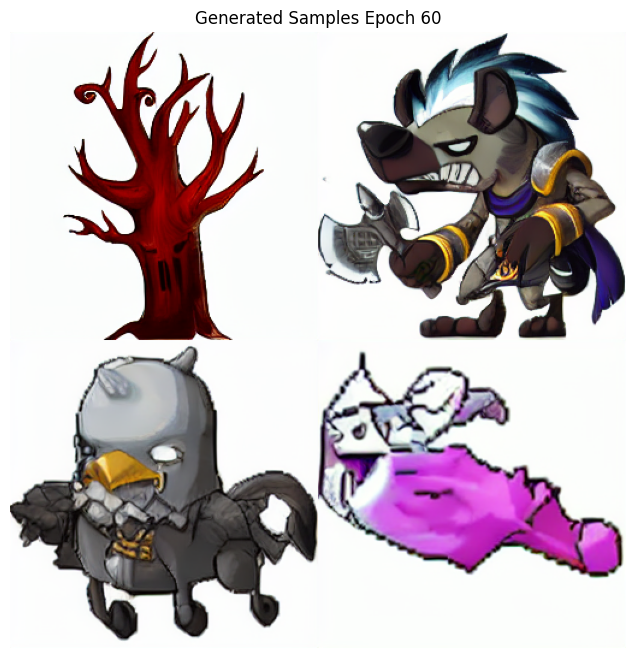

[Epoch 60] Save Checkpoint


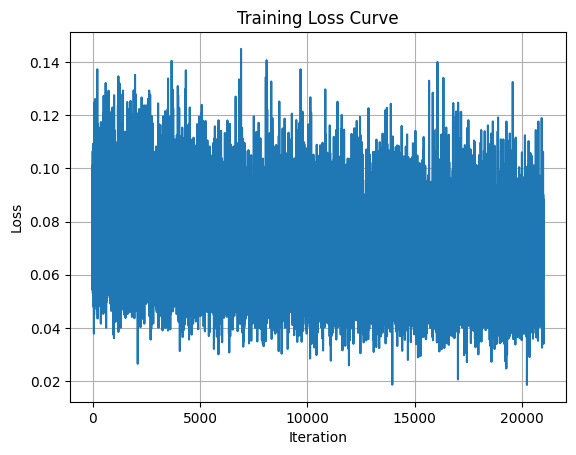

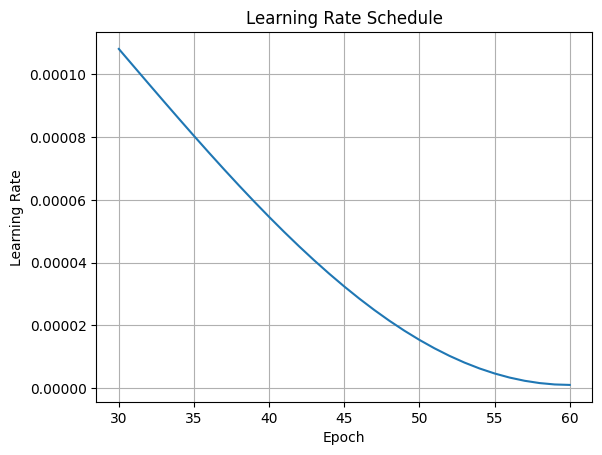

In [ ]:
resume_train_from_checkpoint(
    "/content/drive/MyDrive/DDIM11/ckpt/checkpoint_epoch29.pt",
    train_epochs=60)